# Stable Diffusion Benchmark

In [1]:
!nvidia-smi

Fri Dec 16 09:12:41 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.142.00   Driver Version: 450.142.00   CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            On   | 00000000:00:1E.0 Off |                    0 |
| N/A   42C    P0    26W /  70W |   1220MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
import torch
torch.cuda.set_device(0)

In [3]:
# !pip install -Uq diffusers transformers fastcore

## Using Stable Diffusion

To run Stable Diffusion on your computer you have to accept the model license. It's an open CreativeML OpenRail-M license that claims no rights on the outputs you generate and prohibits you from deliberately producing illegal or harmful content. The [model card](https://huggingface.co/CompVis/stable-diffusion-v1-4) provides more details. If you do accept the license, you need to be a registered user in 🤗 Hugging Face Hub and use an access token for the code to work. You have two options to provide your access token:

* Use the `huggingface-cli login` command-line tool in your terminal and paste your token when prompted. It will be saved in a file in your computer.
* Or use `notebook_login()` in a notebook, which does the same thing.

In [1]:
from PIL import Image
from fastcore.all import concat
import torch, logging
from pathlib import Path
from huggingface_hub import notebook_login
from diffusers import StableDiffusionPipeline
from PIL import Image
import matplotlib.pyplot as plt
logging.disable(logging.WARNING)

if not (Path.home()/'.huggingface'/'token').exists(): notebook_login()

In [2]:
from tqdm.auto import tqdm

In [3]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

# Test pipeline

In [14]:
prompts = [
    'An astronaut riding a horse',
    'A handsome businesssman working',
    'A hand shake',
    'A woman eating an ice cream'
]
guidance_scale = 7.5
num_inference_steps = 50

device = torch.device("cuda")
num_images_per_prompt = 2

In [15]:
from diffusers import StableDiffusionPipeline, EulerDiscreteScheduler
import torch

model_id = "stabilityai/stable-diffusion-2-1-base"

# Use the Euler scheduler here instead
scheduler = EulerDiscreteScheduler.from_pretrained(model_id, subfolder="scheduler")
pipe = StableDiffusionPipeline.from_pretrained(model_id, scheduler=scheduler, revision="fp16", torch_dtype=torch.float16)
pipe = pipe.to("cuda")

Fetching 12 files:   0%|          | 0/12 [00:00<?, ?it/s]

In [16]:
torch.manual_seed(42)
images = pipe(prompts, 
             guidance_scale=guidance_scale, 
             num_inference_steps=num_inference_steps, 
             num_images_per_prompt=num_images_per_prompt).images

  0%|          | 0/50 [00:00<?, ?it/s]

In [17]:
len(images)

8

In [18]:
ref_images = images.copy()

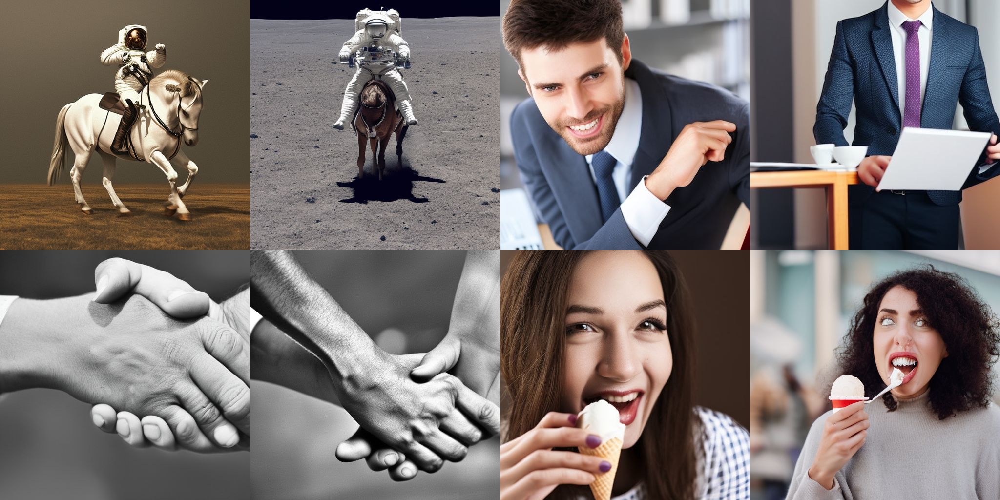

In [19]:
image_grid(ref_images, rows=num_images_per_prompt, cols=len(prompts))

# Reproduce inference loop 

In [25]:
def regular_update(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

    # compute the previous noisy sample x_t -> x_t-1
    latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    return latents

In [26]:
def my_sd_sampling(prompt=prompts, device=device, 
             guidance_scale=guidance_scale, 
             num_inference_steps=num_inference_steps, 
             num_images_per_prompt=num_images_per_prompt, 
             custom_update=None):
    
    # 0. Default height and width to unet
    height = pipe.unet.config.sample_size * pipe.vae_scale_factor
    width = pipe.unet.config.sample_size * pipe.vae_scale_factor

    # 1. Check inputs. Raise error if not correct
    pipe.check_inputs(prompt, height, width, callback_steps=1)

    # 2. Define call parameters
    batch_size = 1 if isinstance(prompt, str) else len(prompt)

    # here `guidance_scale` is defined analog to the guidance weight `w` of equation (2)
    # of the Imagen paper: https://arxiv.org/pdf/2205.11487.pdf . `guidance_scale = 1`
    # corresponds to doing no classifier free guidance.
    do_classifier_free_guidance = guidance_scale > 1.0

    # 3. Encode input prompt
    text_embeddings = pipe._encode_prompt(prompt, device, num_images_per_prompt, 
                                          do_classifier_free_guidance, negative_prompt=None)

    # 4. Prepare timesteps
    pipe.scheduler.set_timesteps(num_inference_steps, device=device)
    timesteps = pipe.scheduler.timesteps

    # 5. Prepare latent variables
    num_channels_latents = pipe.unet.in_channels
    latents = pipe.prepare_latents(
        batch_size * num_images_per_prompt,
        num_channels_latents,
        height,
        width,
        text_embeddings.dtype,
        device,
        generator=None,
        latents=None,
    )

    with torch.no_grad():
        # 7. Denoising loop
        for i, t in enumerate(pipe.progress_bar(timesteps)):
            if custom_update is not None:
                latents = custom_update(latents, i, t, text_embeddings, do_classifier_free_guidance)
            else:
                latents = regular_update(latents, i, t, text_embeddings, do_classifier_free_guidance)

        # 8. Post-processing
        image = pipe.decode_latents(latents)

        # 9. Run safety checker
        image, has_nsfw_concept = pipe.run_safety_checker(image, device, text_embeddings.dtype)
        
        # 10. Convert to PIL
        images = pipe.numpy_to_pil(image)
    
    return images

In [22]:
torch.manual_seed(42)
imgs = my_sd_sampling()

  0%|          | 0/50 [00:00<?, ?it/s]

In [24]:
import numpy as np
assert np.sum(np.array(imgs[0])-np.array(ref_images[0]))==0

In [23]:
# image_grid(ref_images + imgs, rows=2*num_images_per_prompt, cols=len(prompts))

# Improve the pipeline with "whole" rescale

In [27]:
def update_with_rescale(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)
        noise_pred = noise_pred/noise_pred.norm()*noise_pred_uncond.norm()

    # compute the previous noisy sample x_t -> x_t-1
    latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    return latents

In [28]:
torch.manual_seed(42)
imgs = my_sd_sampling(custom_update=update_with_rescale)

  0%|          | 0/50 [00:00<?, ?it/s]

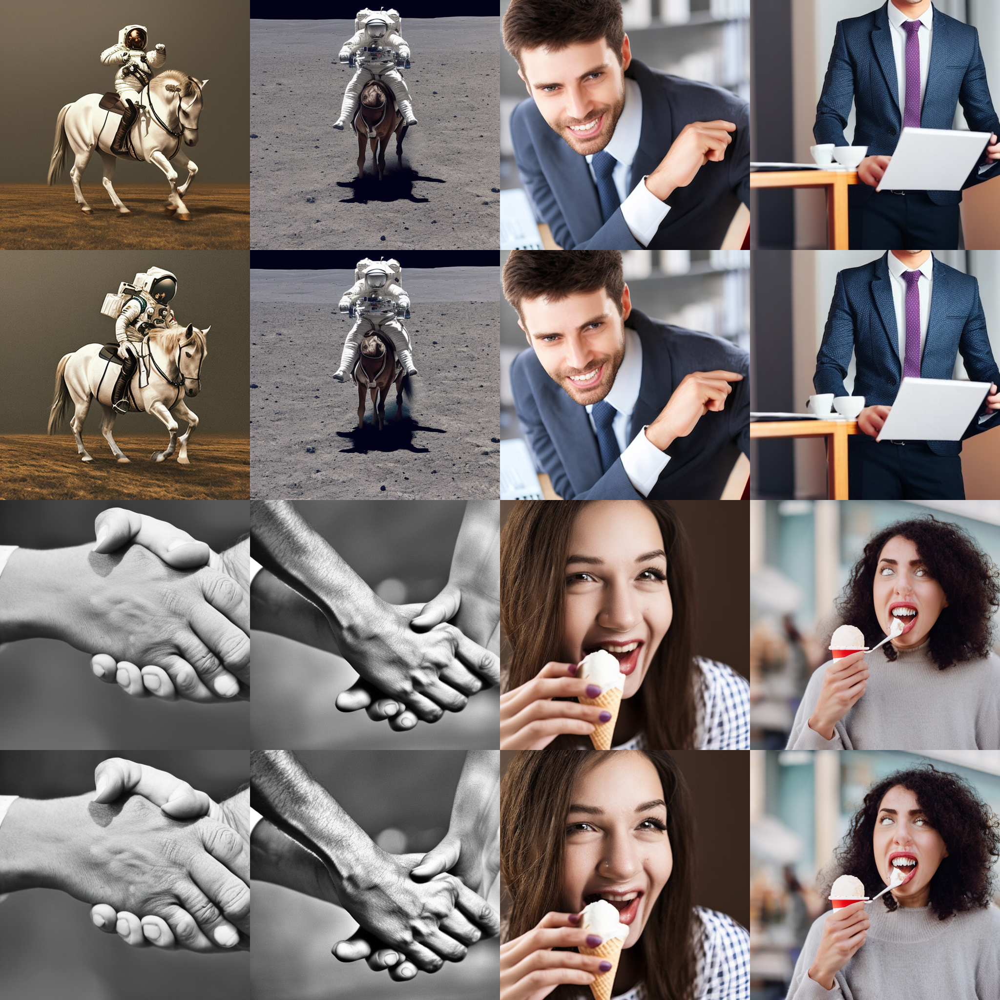

In [31]:
image_grid(ref_images[:len(prompts)] + imgs[:len(prompts)] 
           + ref_images[len(prompts):] + imgs[len(prompts):], rows=2*num_images_per_prompt, cols=len(prompts))

In [32]:
mstn1 = imgs.copy()

# Improve the pipeline with another rescale

In [33]:
def update_with_rescale(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        dir_change = noise_pred_text/noise_pred_text.norm() - noise_pred_uncond/noise_pred_uncond.norm()
        noise_pred = noise_pred_uncond + guidance_scale * dir_change * noise_pred_uncond.norm()
#         noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)
#         noise_pred = noise_pred/noise_pred.norm()*noise_pred_uncond.norm()

    # compute the previous noisy sample x_t -> x_t-1
    latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    return latents

In [34]:
torch.manual_seed(42)
imgs = my_sd_sampling(custom_update=update_with_rescale)

  0%|          | 0/50 [00:00<?, ?it/s]

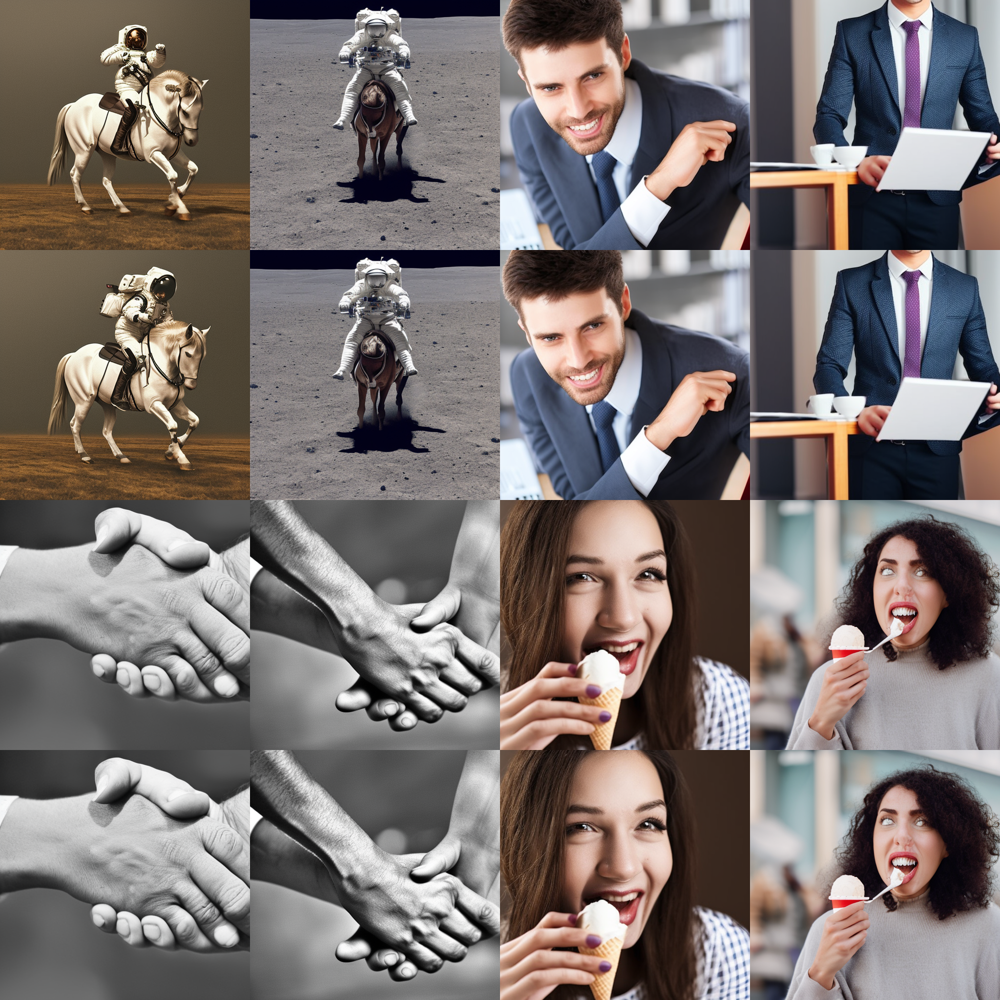

In [35]:
image_grid(ref_images[:len(prompts)] + imgs[:len(prompts)] 
           + ref_images[len(prompts):] + imgs[len(prompts):], rows=2*num_images_per_prompt, cols=len(prompts))

# Log some graphs into the pipeline

In [38]:
def update_with_debug_logs(latents, i, t, text_embeddings, do_classifier_free_guidance):
    traj_pts_times.append(t)
    traj_pts_values.append(latents)

    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

    # compute the previous noisy sample x_t -> x_t-1
    new_latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    latent_step = new_latents-latents 
    steps_unit_vecs.append(latent_step/latent_step.norm()) 
    steps_magnitudes.append(latent_step.norm())
    return new_latents

In [39]:
steps_unit_vecs = []
steps_magnitudes = []
traj_pts_times = []
traj_pts_values = []

In [40]:
torch.manual_seed(42)
imgs = my_sd_sampling(custom_update=update_with_debug_logs)

  0%|          | 0/50 [00:00<?, ?it/s]

In [41]:
# image_grid(ref_images[:len(prompts)] + imgs[:len(prompts)] 
#            + ref_images[len(prompts):] + imgs[len(prompts):], rows=2*num_images_per_prompt, cols=len(prompts))

In [42]:
dir_cosine_sim = [ (steps_unit_vecs[i+1].view(1, -1) @ steps_unit_vecs[i].view(1, -1).T).detach().cpu().numpy() 
                    for i in range(len(steps_unit_vecs)-1)]

In [43]:
dir_changes_norm = [(steps_unit_vecs[i+1] - steps_unit_vecs[i]).norm().detach().cpu().numpy() 
                    for i in range(len(steps_unit_vecs)-1)]
steps_norm = [sn.detach().cpu().numpy() for sn in steps_magnitudes]

Text(0.5, 1.0, 'Step Length')

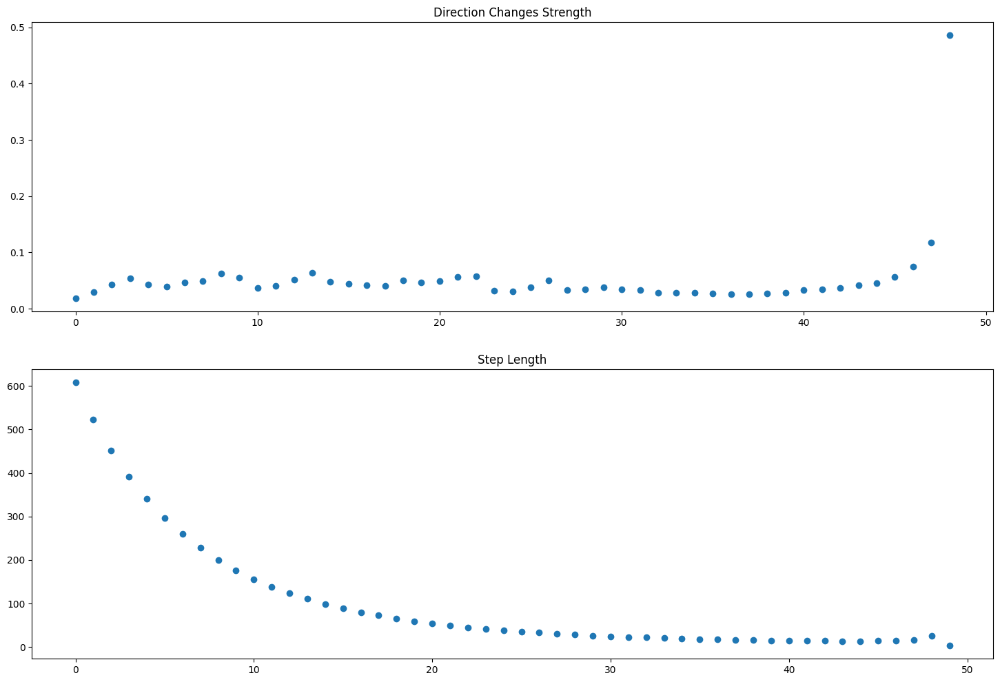

In [44]:
fig, axs = plt.subplots(2, 1, figsize=(18, 12))
axs[0].scatter(range(len(dir_changes_norm)), dir_changes_norm)
axs[0].set_title("Direction Changes Strength")
axs[1].scatter(range(len(steps_norm)), steps_norm)
axs[1].set_title("Step Length")

Note that the direction seems to be changing a lot at the end. This tends to make me think that the algorithm overshoots a bit at the end. Maybe this is something we can fix! 

# Prevent overshooting at the end

In [45]:
def update_without_overshoot(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

    # compute the previous noisy sample x_t -> x_t-1
    new_latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    if i>=round(0.8*num_inference_steps) and i!=num_inference_steps-1:
        new_latents = latents + 0.85 * (new_latents-latents)
        
    latent_step = new_latents-latents 
    steps_unit_vecs.append(latent_step/latent_step.norm()) 
    steps_magnitudes.append(latent_step.norm())
    return new_latents

In [46]:
steps_unit_vecs = []
steps_magnitudes = []

In [47]:
torch.manual_seed(42)
imgs = my_sd_sampling(custom_update=update_without_overshoot)

  0%|          | 0/50 [00:00<?, ?it/s]

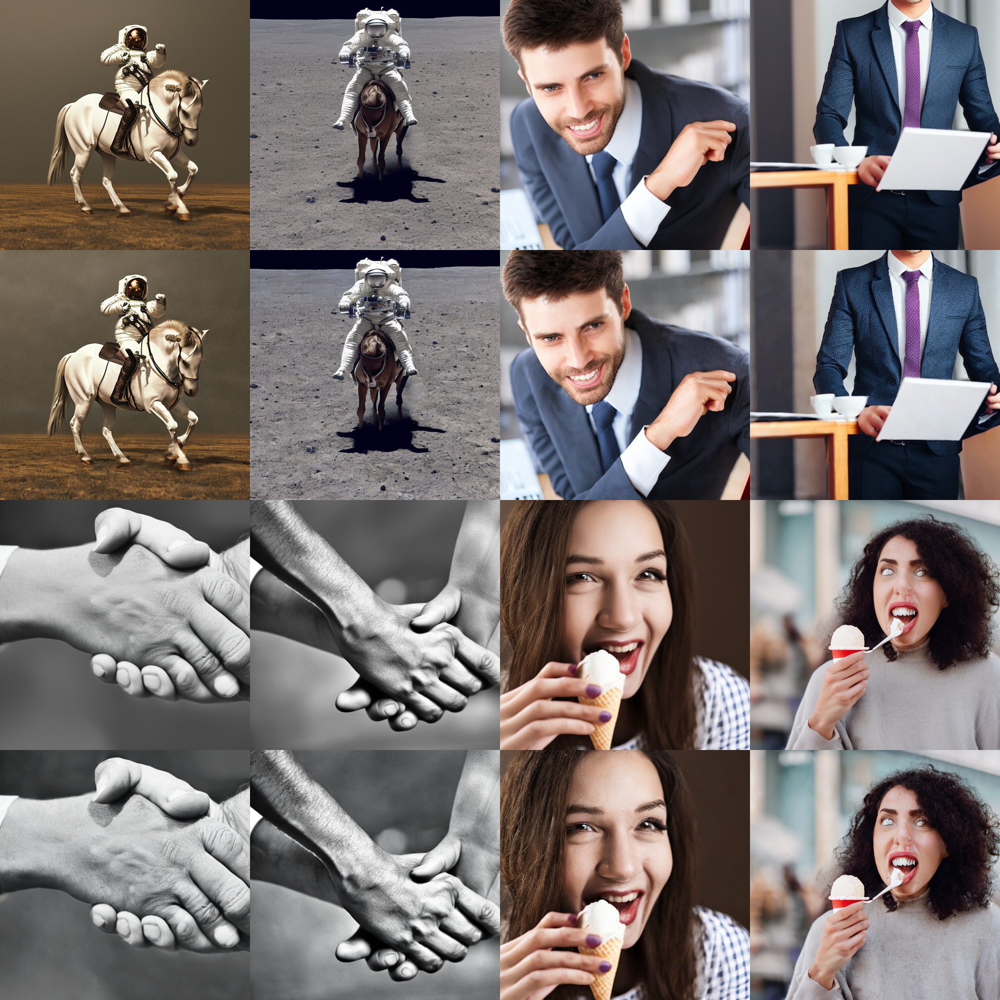

In [50]:
image_grid(ref_images[:len(prompts)] + imgs[:len(prompts)] 
           + ref_images[len(prompts):] + imgs[len(prompts):], rows=2*num_images_per_prompt, cols=len(prompts))

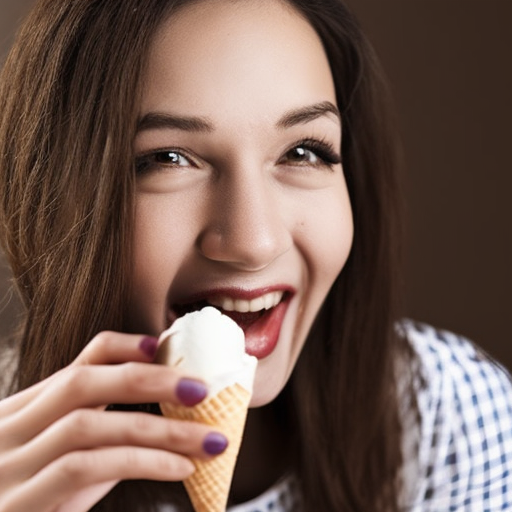

In [53]:
ref_images[-2]

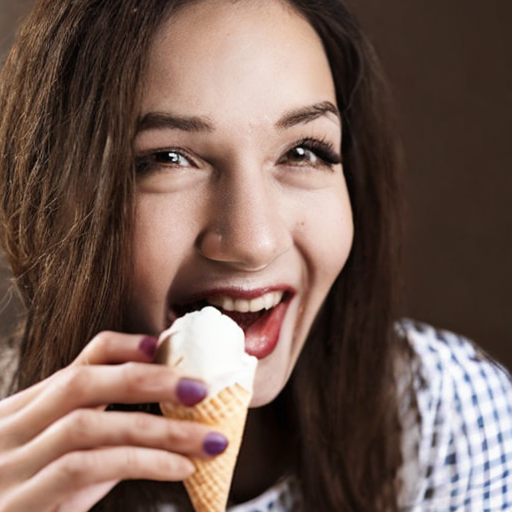

In [51]:
imgs[-2]

It does seem like the images look a little bit realistic with this fix!

# Polynomial Interpolation of Latents

In [54]:
import numpy as np

In [60]:
def my_new_sd_sampling(prompt=prompts, device=device, 
             guidance_scale=guidance_scale, 
             num_inference_steps=num_inference_steps, 
             num_images_per_prompt=num_images_per_prompt, 
             custom_update=None):
    
    # 0. Default height and width to unet
    height = pipe.unet.config.sample_size * pipe.vae_scale_factor
    width = pipe.unet.config.sample_size * pipe.vae_scale_factor

    # 1. Check inputs. Raise error if not correct
    pipe.check_inputs(prompt, height, width, callback_steps=1)

    # 2. Define call parameters
    batch_size = 1 if isinstance(prompt, str) else len(prompt)

    # here `guidance_scale` is defined analog to the guidance weight `w` of equation (2)
    # of the Imagen paper: https://arxiv.org/pdf/2205.11487.pdf . `guidance_scale = 1`
    # corresponds to doing no classifier free guidance.
    do_classifier_free_guidance = guidance_scale > 1.0

    # 3. Encode input prompt
    text_embeddings = pipe._encode_prompt(prompt, device, num_images_per_prompt, 
                                          do_classifier_free_guidance, negative_prompt=None)

    # 4. Prepare timesteps
    pipe.scheduler.set_timesteps(num_inference_steps, device=device)
    timesteps = pipe.scheduler.timesteps

    # 5. Prepare latent variables
    num_channels_latents = pipe.unet.in_channels
    latents = pipe.prepare_latents(
        batch_size * num_images_per_prompt,
        num_channels_latents,
        height,
        width,
        text_embeddings.dtype,
        device,
        generator=None,
        latents=None,
    )

    with torch.no_grad():
        
        traj_pts_times, traj_pts_values = [], []
        # 7. Denoising loop
        for i, t in enumerate(pipe.progress_bar(timesteps)):
            traj_pts_times.append(t)
            traj_pts_values.append(latents)
            if custom_update is not None:
                latents = custom_update(latents, i, t, text_embeddings, do_classifier_free_guidance)
            else:
                latents = regular_update(latents, i, t, text_embeddings, do_classifier_free_guidance)
        
        latents = compute_converged_latent(traj_pts_times, traj_pts_values)
        
        traj_pts_times, traj_pts_values = [], []
        # 8. Post-processing
        image = pipe.decode_latents(latents)

        # 9. Run safety checker
        image, has_nsfw_concept = pipe.run_safety_checker(image, device, text_embeddings.dtype)
        
        # 10. Convert to PIL
        images = pipe.numpy_to_pil(image)
    
    return images

In [61]:
def compute_converged_latent(traj_pts_times, traj_pts_values):
    bs = traj_pts_values[0].shape[0]
    pts = torch.stack([pt.flatten() for pt in traj_pts_values])
    times = torch.Tensor([t for t in traj_pts_times])
    times = 999-times
    coefficients, residuals, rank, singular_values, rcond = np.polyfit(times.float().detach().cpu().numpy()[:], 
                                                                   pts.float().detach().cpu().numpy()[:], 
                                                                   deg=6, full=True)
    y_pred = np.polyval(coefficients, 1024)
    converged_latents = torch.from_numpy(y_pred).view(4, 4, 64, 64).half().to(device)
    return converged_latents

In [62]:
torch.manual_seed(42)
imgs = my_new_sd_sampling()

  0%|          | 0/50 [00:00<?, ?it/s]

RuntimeError: shape '[4, 4, 64, 64]' is invalid for input of size 131072

In [ ]:
image_grid(ref_images[:len(prompts)] + imgs[:len(prompts)] 
           + ref_images[len(prompts):] + imgs[len(prompts):], rows=2*num_images_per_prompt, cols=len(prompts))

In [ ]:
imgs[0]

In [ ]:
ref_images[0]

# Everything combined

In [137]:
def update_with_rescale(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        dir_change = noise_pred_text/noise_pred_text.norm() - noise_pred_uncond/noise_pred_uncond.norm()
        noise_pred = noise_pred_uncond + guidance_scale * dir_change * noise_pred_uncond.norm()
#         noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)
        noise_pred = noise_pred/noise_pred.norm()*noise_pred_text.norm()

    # compute the previous noisy sample x_t -> x_t-1
    new_latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    if i>=round(0.8*num_inference_steps) and i!=num_inference_steps-1:
        new_latents = latents + 0.85 * (new_latents-latents)
        
    latent_step = new_latents-latents 
    steps_unit_vecs.append(latent_step/latent_step.norm()) 
    steps_magnitudes.append(latent_step.norm())
    return new_latents

In [138]:
def compute_converged_latent(traj_pts_times, traj_pts_values):
    bs = len(traj_pts_values[0])
    pts = torch.stack([pt.flatten() for pt in traj_pts_values])
    times = torch.Tensor([t for t in traj_pts_times])
    times = 999-times
    coefficients, residuals, rank, singular_values, rcond = np.polyfit(times.float().detach().cpu().numpy()[:], 
                                                                   pts.float().detach().cpu().numpy()[:], 
                                                                   deg=6, full=True)
    y_pred = np.polyval(coefficients, 1024)
    
    converged_latents = torch.from_numpy(y_pred).view(4, 4, 64, 64).half().to(device)
    return converged_latents

In [139]:
def my_new_sd_sampling(prompt=prompts, device=device, 
             guidance_scale=guidance_scale, 
             num_inference_steps=num_inference_steps, 
             num_images_per_prompt=num_images_per_prompt, 
             custom_update=None):
    
    # 0. Default height and width to unet
    height = pipe.unet.config.sample_size * pipe.vae_scale_factor
    width = pipe.unet.config.sample_size * pipe.vae_scale_factor

    # 1. Check inputs. Raise error if not correct
    pipe.check_inputs(prompt, height, width, callback_steps=1)

    # 2. Define call parameters
    batch_size = 1 if isinstance(prompt, str) else len(prompt)

    # here `guidance_scale` is defined analog to the guidance weight `w` of equation (2)
    # of the Imagen paper: https://arxiv.org/pdf/2205.11487.pdf . `guidance_scale = 1`
    # corresponds to doing no classifier free guidance.
    do_classifier_free_guidance = guidance_scale > 1.0

    # 3. Encode input prompt
    text_embeddings = pipe._encode_prompt(prompt, device, num_images_per_prompt, 
                                          do_classifier_free_guidance, negative_prompt=None)

    # 4. Prepare timesteps
    pipe.scheduler.set_timesteps(num_inference_steps, device=device)
    timesteps = pipe.scheduler.timesteps

    # 5. Prepare latent variables
    num_channels_latents = pipe.unet.in_channels
    latents = pipe.prepare_latents(
        batch_size * num_images_per_prompt,
        num_channels_latents,
        height,
        width,
        text_embeddings.dtype,
        device,
        generator=None,
        latents=None,
    )

    with torch.no_grad():
        
        traj_pts_times, traj_pts_values = [], []
        # 7. Denoising loop
        for i, t in enumerate(pipe.progress_bar(timesteps)):
            traj_pts_times.append(t)
            traj_pts_values.append(latents)
            if custom_update is not None:
                latents = custom_update(latents, i, t, text_embeddings, do_classifier_free_guidance)
            else:
                latents = regular_update(latents, i, t, text_embeddings, do_classifier_free_guidance)
        
        latents = compute_converged_latent(traj_pts_times, traj_pts_values)
        
        traj_pts_times, traj_pts_values = [], []
        # 8. Post-processing
        image = pipe.decode_latents(latents)

        # 9. Run safety checker
        image, has_nsfw_concept = pipe.run_safety_checker(image, device, text_embeddings.dtype)
        
        # 10. Convert to PIL
        images = pipe.numpy_to_pil(image)
    
    return images

In [140]:
torch.manual_seed(42)
imgs = my_new_sd_sampling(custom_update=update_with_rescale)

  0%|          | 0/50 [00:00<?, ?it/s]

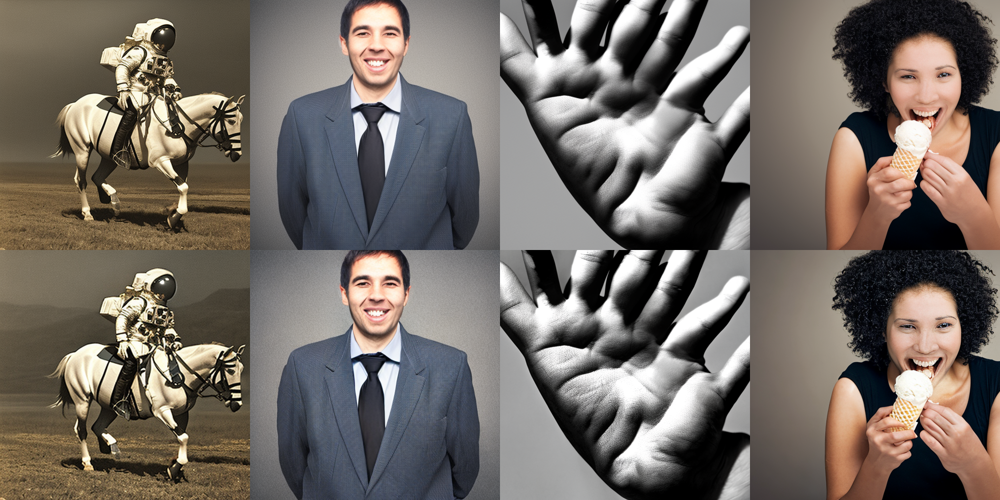

In [141]:
image_grid(ref_images + imgs, rows=2, cols=len(prompts))